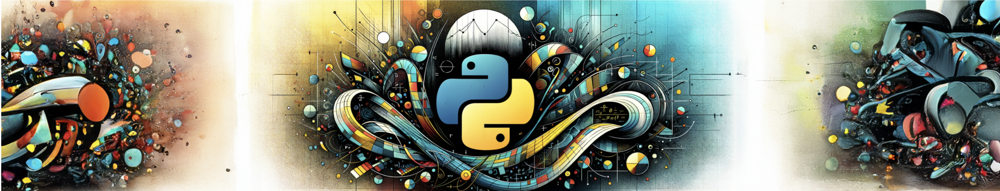

# Webinar 3 - Løsning av likninger 
## Læringsmål

- Løse likninger med prøve og feile metoden
- Løse likninger med halveringsmetoden
- Løse likninger med andre metoder
- Løse likninger med Newtons metode



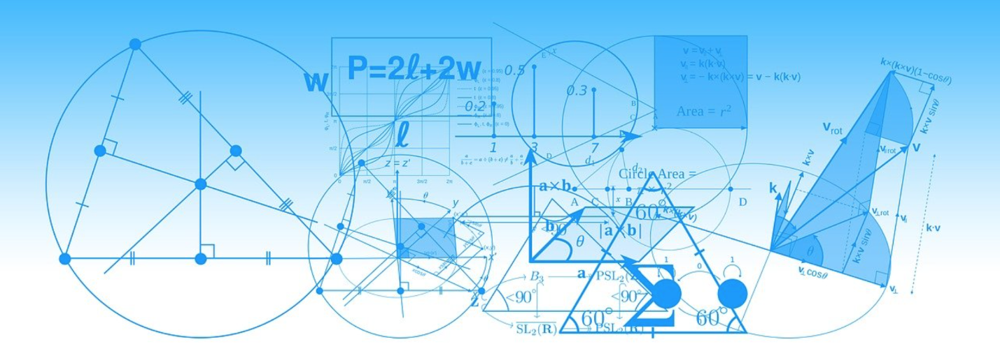

## Prøve og feile metoden

### Eksempel 1

Du setter 10 000 kroner inn på en bankkonto med 3% rente. Hvor mange år tar det før pengene har doblet seg? 

### Eksempel 2 

Løs likningen $3000\cdot 1.018^x = 5000$

### Eksempel 3

Vi ønsker å finne alle nullpunktene til funksjonen 
$f(x)=e^x-x-\dfrac{3}{2}$. 

* Hvor mange nullpunkt kan funksjonen ha? 

* Hvilket intervall vil vi lete i? 

* Kan vi lage en algoritme som finner alle? 

In [8]:
import ipywidgets as widgets 
from IPython.display import display
import numpy as np  #
import matplotlib.pyplot as plt

def f(x):
    return np.exp(x)-x-3/2
plt.style.use("seaborn-v0_8")

@widgets.interact(d=(0, 2, 0.01), n=(0, 50, 1), x0=(-3, 2, 0.1))
def diskret(x0=-3, n=0, d=0.5):
    plt.figure(figsize=(12, 6))
    X = np.linspace(-3, 2.5, 100)
    plt.ylim(-1, 2)
    plt.plot(X, f(X))
    plt.hlines(0, -3, 2.5, color="black")
    if f(x0+n*d)>0:
        plt.scatter(x0+n*d, 0, color="g", s=100)
    else:
        plt.scatter(x0+n*d, 0, color="y", s=100)
    if f(x0+(n+1)*d)>0:
        plt.scatter(x0+(n+1)*d, 0, color="g", s=100)
    else:
        plt.scatter(x0+(n+1)*d, 0, color="y", s=100)
    plt.text(x0+n*d, -.23, r"$x_0$", fontdict={"fontsize": 20}, horizontalalignment="center")
    plt.text(x0+(n+1)*d, .14, r"$x_0+d$",
         fontdict={"fontsize": 20}, horizontalalignment="center")


interactive(children=(FloatSlider(value=-3.0, description='x0', max=2.0, min=-3.0), IntSlider(value=0, descrip…

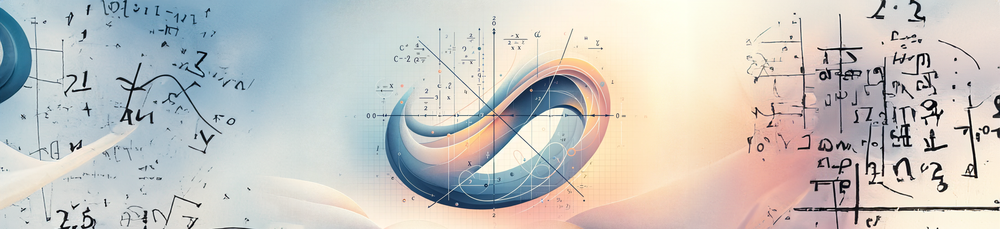

## Halveringsmetoden for å finne nullpunkt til en funksjon



In [27]:
import numpy as np
import matplotlib.pyplot as plt 


n = 11
A = [0]
B = [2]
M = [1]
@widgets.interact(steg=(0, 10, 1))
def halv(steg= 0):
    X = np.linspace(0, 2, 100)
    def f(x):
        return -2*x**3+6*x**2-5
    plt.figure(figsize=(12, 6))
    plt.plot(X, f(X))
    plt.hlines(0, 0, 2)
    plt.ylim(-6, 4)
    a = 0
    b = 2
    for i in range(n):
        m = (a+b)/2
        if f(a)*f(m)<0:
            b = m
        else:
            a = m
        A.append(a)
        B.append(b)
        M.append(m)
    for i in range(n+1):
        if i == steg:
            plt.scatter([A[steg], M[steg+1], B[steg]], [0,0,0])
            if f(A[steg])>=0:
                plt.plot([A[steg], A[steg]], [0, f(A[steg])], color="b")
            else:
                plt.plot([A[steg], A[steg]], [0, f(A[steg])], color="r")
            if f(B[steg])>=0:
                plt.plot([B[steg], B[steg]], [0, f(B[steg])], color="b")
            else:
                plt.plot([A[steg], A[steg]], [0, f(A[steg])], color="r")
            plt.text(A[steg], 0.2, "a", fontsize=16, horizontalalignment='center')
            plt.text(B[steg], 0.2, "b", fontsize=16, horizontalalignment='center')
            plt.text(M[steg+1], 0.2, "m", fontsize=16, horizontalalignment='center')
            plt.scatter(M[steg+1], 0, color="g", lw=4)


interactive(children=(IntSlider(value=0, description='steg', max=10), Output()), _dom_classes=('widget-interac…

> __Halveringsmetoden:__
>
>Vi ønsker å finne et nullpunkt til en funksjon $f$ i intervallet $[a , b]$.
>
>**Input:** Funksjonen $f$, tallene $a$, $b$ og antall ganger vi skal halvere $n$
>
>**Gjenta** $n$ ganger:
>
> &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;$ m = \dfrac{a+b}{2}$
>
>&nbsp; &nbsp; &nbsp; &nbsp; &nbsp;**Hvis** $f(a)$ og $f(m)$ har ulikt fortegn, lar vi $b=m$
>&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; 
>
>&nbsp; &nbsp; &nbsp; &nbsp; &nbsp;**Ellers** lar vi $a = m $
>
>Da er $\dfrac{a+b}{2}$ en god tilnærming for et nullpunkt til $f$ i $[a , b]$.
>

### Eksempel 4

a) Begrunn at likiningen $x^3+2x=1$ har én og bare én reell løsning. 

b) Lag et program som løser likningen ved å bruke halveringsmetoden.


Likningens reelle løsning er 

$$x={\frac{1}{3} \cdot \frac{{3\;{\kern 1pt} {{\sqrt[3]{{\frac{1}{{18}}\;{\kern 1pt} \left( {\sqrt {177}  + 9} \right)}}}^2} - 2}}{{\sqrt[3]{{\frac{1}{{18}}\;{\kern 1pt} \left( {\sqrt {177}  + 9} \right)}}}}}$$



## Ferdige funksjoner for å løse likninger

Det fins mange ferdige funksjoner for å løse likninger i Python. Noen av dem er:

- sympy
- numpy
- scipy
- fsolve
- bisection
- newton-raphson
- secant
- brentq
- ridder
- bisect
- newton
- fixed_point
- root_scalar
- root

### Eksempel 5

Løs likningen $x^3-2x^2=2x-4$ med sympy, numpy, scipy og fsolve.

## Newtons metode

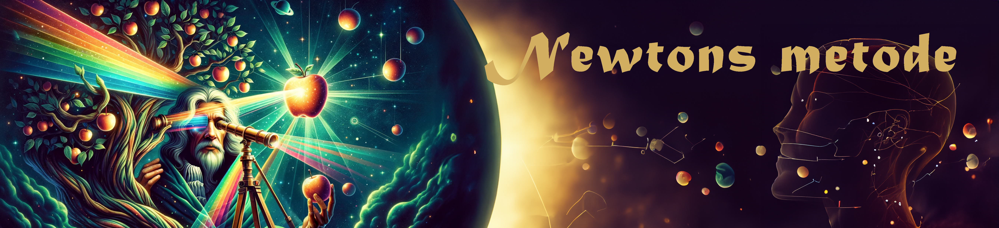

In [13]:
import ipywidgets as widgets 
import numpy as np  #
import matplotlib.pyplot as plt

def f(x):
    return x**3-5*x+3
def Df(x):
    return 3*x**2-5

@widgets.interact(n=(0, 9, 1))
def New(n=0):
    x0=3
    xmin=-0.5
    xmax=4
    ymin=-2
    ymax=16
    # Setter opp x-verdier
    X = np.linspace(xmin, xmax, 200)
    plt.figure(figsize=(12, 8))
    plt.plot(X, f(X)) # Plotter funksjonen
    plt.xlim(xmin, xmax) # Setter x-verdier
    plt.ylim(ymin, ymax) # Setter y-verdier
    plt.hlines(0, -4, 4, color="black") # Setter horisontal linje
    plt.vlines(0, -9, 20, color="black") # Setter vertikale linjer

    plt.scatter(x0, 0, color="g") # Plotterer punkt
    for i in range(10):
        if n > i:
            plt.plot([x0, x0], [0, f(x0)], "go-")
            plt.plot(X, (X-x0)*Df(x0)+f(x0), "crimson")
            x0 = x0 - f(x0)/(Df(x0))
    

interactive(children=(IntSlider(value=0, description='n', max=9), Output()), _dom_classes=('widget-interact',)…

> __Newtons metode__   
> 
> Gitt en deriverbar funksjon $f$. Velg en startverdi $x_0$ og la
>
> &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;$  x_{n+1}= x_n-\dfrac{f(x_n)}{f'(x_n)}$
>
> For mange funksjoner vil da tallene $x_0, x_1, x_2, \ldots$ konvergere mot et nullpunkt til $f$.

###  Eksempel 5

Løs likningen $x^3-5x-1=0$ ved å bruke Newtons metode